In [1]:
import numpy as np
import pandas as pd
import tqdm
import re
#from lightfm import LightFM
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

from tqdm import tqdm_notebook
import warnings
warnings.filterwarnings("ignore")
from sklearn import preprocessing

In [2]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

In [3]:
books = pd.read_csv("BX-Books.csv")
interactions = pd.read_csv("BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")
users = pd.read_csv('BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [4]:
interactions = interactions[interactions["Book-Rating"] != 0]
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])
interactions = interactions[(interactions["user_num"]  > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title", "Book-Author", "Publisher"]].rename(
                                  columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

from sklearn import preprocessing
le = preprocessing.LabelEncoder()
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["user_id"] = le.fit_transform(interactions["User-ID"])

csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["product_id"], interactions["user_id"])), 
                            shape=(len(set(interactions["product_id"])), len(set(interactions["user_id"]))))

In [5]:
users = users.fillna(int(np.mean(users['Age'])))

In [6]:
#books
interactions
#users

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,Book-Author,Publisher,product_id,user_id
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,3445
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,5248
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,2622
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,10887
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,4228
...,...,...,...,...,...,...,...,...,...,...,...
110514,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,Max Lucado,W Publishing Group,9478,1035
110515,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,Haruki Murakami,Havill Pr,10209,8112
110516,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,Alan H. Cohen,Jodere Group,10138,8754
110517,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,C. S. Lewis,Harper SanFrancisco,276,3740


# Персональный топ

In [7]:
book_rating = np.true_divide(csr_rates.sum(1),(csr_rates!=0).sum(1)).tolist()

In [8]:
book_rating_col = []
for pid in interactions["product_id"]:
    book_rating_col.append(book_rating[pid][0])
interactions['Book-Rating-mean'] = book_rating_col
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,Book-Author,Publisher,product_id,user_id,Book-Rating-mean
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,3445,8.833333
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,5248,8.833333
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,2622,8.833333
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,10887,8.833333
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,LÃ?Â¼bbe,10397,4228,8.833333
...,...,...,...,...,...,...,...,...,...,...,...,...
110514,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,Max Lucado,W Publishing Group,9478,1035,10.000000
110515,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,Haruki Murakami,Havill Pr,10209,8112,9.000000
110516,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,Alan H. Cohen,Jodere Group,10138,8754,8.000000
110517,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,C. S. Lewis,Harper SanFrancisco,276,3740,9.000000


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001D33C67BBC8>]],
      dtype=object)

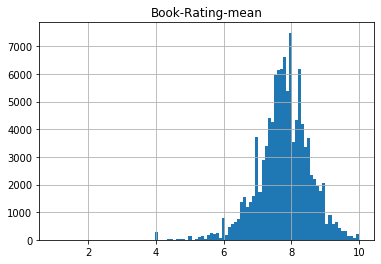

In [35]:
interactions.hist(column = 'Book-Rating-mean', bins = 100)

In [89]:
class Top():
    def __init__(self, interactions):
        self.pid_to_url = {}
        for i in interactions[['product_id','picture_url']].drop_duplicates().values:
            self.pid_to_url[i[0]] = i[1]
        self.interactions = interactions
    
    def top_items(self, top_n = 10, country = None, age = None, group = None):
        df = self.interactions[self.interactions['Book-Rating-mean'] > 7.5]
        if age:
            df = df[self.interactions['age_group'] == age]
        if country:
            df = df[self.interactions['country'] == country]
        if group:
            df = df[self.interactions['user-class'] == group]
        items = df.groupby(['product_id', 'Book-Title'])['user_id'].count().reset_index().sort_values('user_id', ascending = False)[:top_n]
        rec_imaging(items["product_id"].values, self.pid_to_url, items["user_id"].values)
        return items['Book-Title'][:top_n]

Топ-10 самых популярных книг со средним рейтингом >7.5

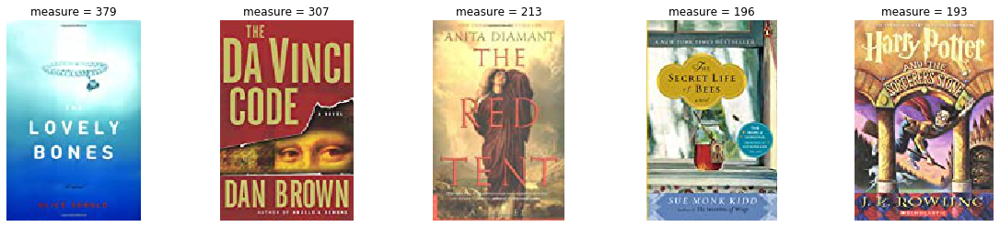

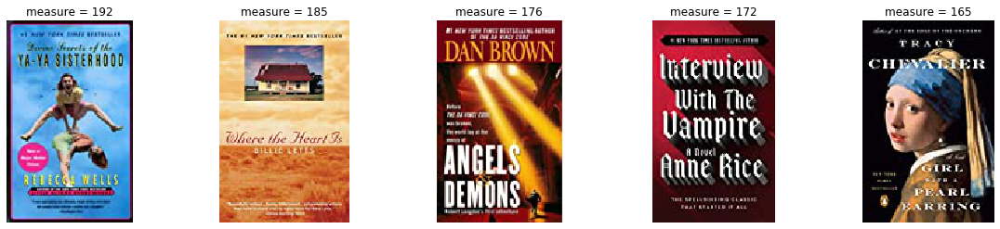

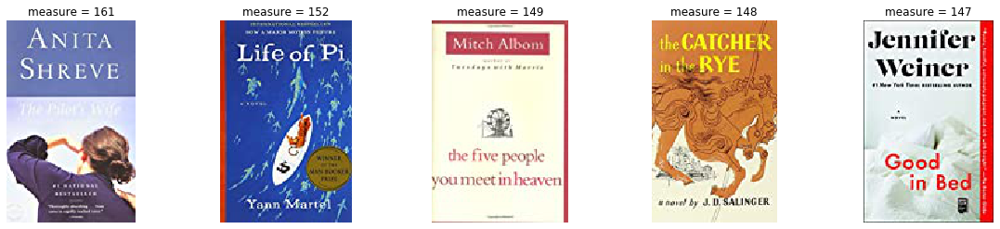

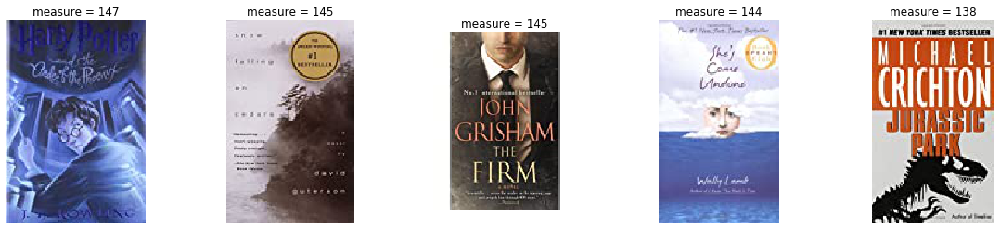

In [177]:
T = Top(interactions)
title = T.top_items(20)

Разделим пользователей на группы по возрасту:
- **1**: 8-12 лет
- **2**: 13-21 лет
- **3**: 22-35 лет
- **4**: 36-60 лет
- **5**: 60-90 лет
- **0**: люди, не указавшие свой возраст (или указавшие очевидно неправильный)

In [133]:
age_group = []
for k in tqdm_notebook(range(len(users['Age']))):
    age = users['Age'][k]
    if age < 8 or age > 90 or age == 34:
        age_group.append(0)
    elif 7 < age < 13:
        age_group.append(1)
    elif 12 < age < 22:
        age_group.append(2)
    elif 21 < age < 36:
        age_group.append(3)
    elif 35 < age < 61:
        age_group.append(4)
    elif 60 < age < 91:
        age_group.append(5)
users['age_group'] = age_group

Выберем страны, в которых больше всего пользователей:
- **1**: canada
- **2**: germany
- **3**: united kingdom
- **4**: usa
- **0**: other

In [61]:
def preprocessor(text):
    text = text.replace('&quot',' ')
    text = text.replace('&apos'," ")
    whitespaced_text = re.sub("[ —!#$&%\()*+,-./:;<=>?@[\\]^_`{|}~»♫1234567890 ]", " ", text.lower())
    whitespaced_text = re.sub('united kingdom', 'unitedkingdom', whitespaced_text)
    return re.sub(' +', ' ',  whitespaced_text)

In [124]:
country = []
for k in tqdm_notebook(range(len(users['Location']))):
    loc_str = preprocessor(users['Location'][k])
    country.append(loc_str.split(" ")[-1])
country_count = {}
for c in set(country):
    country_count[c] = country.count(c)
    
for k in range(len(country)):
    if country_count[country[k]] < 15000:
        country[k] = ''
        
users['country'] = le.fit_transform(country)
set(country)

{'', 'canada', 'germany', 'unitedkingdom', 'usa'}

In [136]:
interactions = interactions.merge(users[["User-ID",'country','age_group']])
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,user_id,Book-Rating-mean,country,age_group
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,3445,8.833333,2,3
1,86583,3453061187,8,13,18,http://images.amazon.com/images/P/3453061187.0...,Die Jury. Roman.,10495,3445,7.857143,2,3
2,86583,3426609061,7,8,18,http://images.amazon.com/images/P/3426609061.0...,House Of God.,10428,3445,5.333333,2,3
3,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10397,5248,8.833333,0,3
4,132500,3499232871,8,11,43,http://images.amazon.com/images/P/3499232871.0...,Herzsprung,10552,5248,6.500000,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...
110514,24172,0590483404,8,9,20,http://images.amazon.com/images/P/0590483404.0...,"A Shocker on Shock Street (Goosebumps, No 35)",7079,879,7.250000,0,4
110515,190082,0525460543,7,6,6,http://images.amazon.com/images/P/0525460543.0...,The Prince of Egypt Collector's Edition Storybook,6211,7498,7.000000,4,4
110516,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,10209,8112,9.000000,3,4
110517,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,10138,8754,8.000000,4,0


</br>
Книги, которые читают дети (8-12 лет):

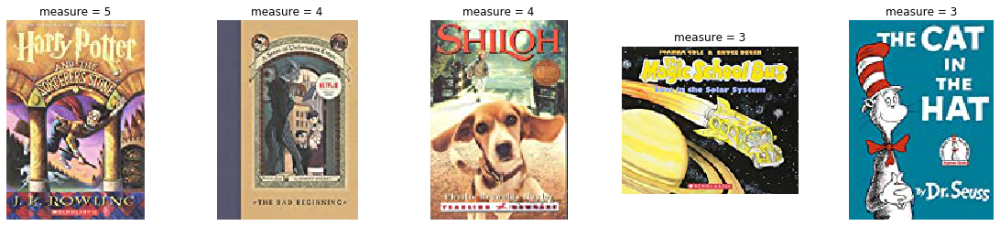

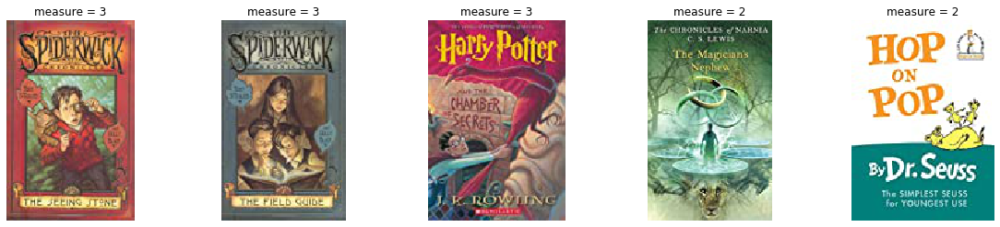

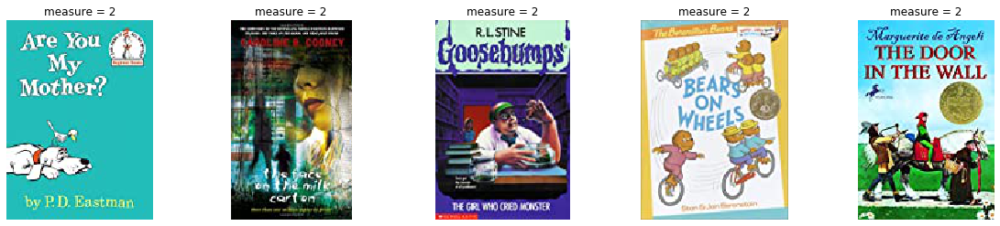

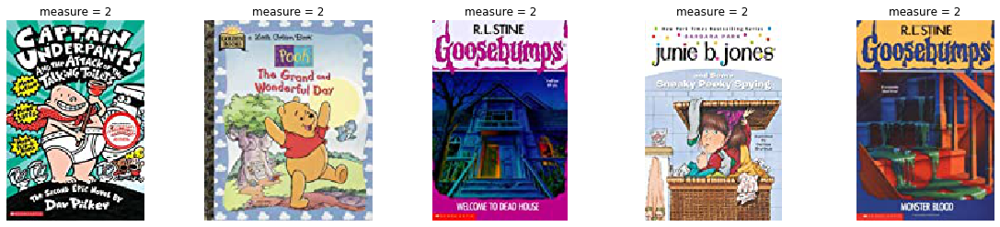

In [200]:
T = Top(interactions)
title = T.top_items(20, age = 1)

In [201]:
title

75    Harry Potter and the Sorcerer's Stone (Harry P...
8     The Bad Beginning (A Series of Unfortunate Eve...
60                            Shiloh (Yearling Newbery)
76    The Magic School Bus Lost in the Solar System ...
42                                   The Cat in the Hat
99    The Seeing Stone (The Spiderwick Chronicles, B...
98    The Field Guide (The Spiderwick Chronicles, Bo...
51     Harry Potter and the Chamber of Secrets (Book 2)
19                The Magician's Nephew (rack) (Narnia)
45    Hop on Pop (I Can Read It All by Myself Beginn...
44                                   Are You My Mother?
57                          The Face on the Milk Carton
79        The Girl Who Cried Monster (Goosebumps, No 8)
47           Bears on Wheels (Bright &amp; Early Books)
59              The Door in the Wall (Yearling Newbery)
84    Captain Underpants and the Attack of the Talki...
31     The Grand and Wonderful Day (Little Golden Book)
77             Welcome to Dead House (Goosebumps

</br>
Книги, которые читают в Америке подростки (13-21 лет):

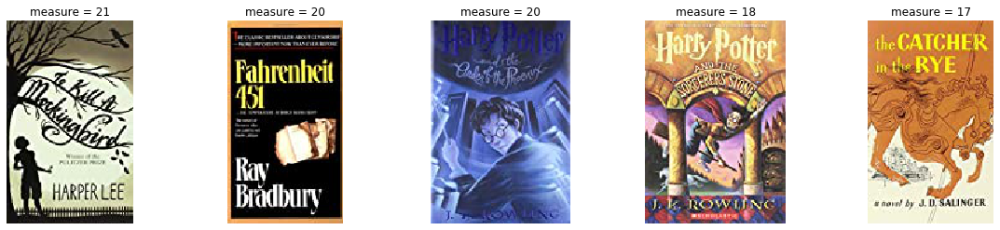

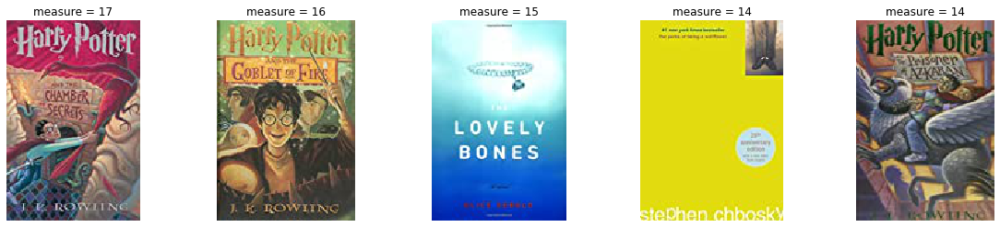

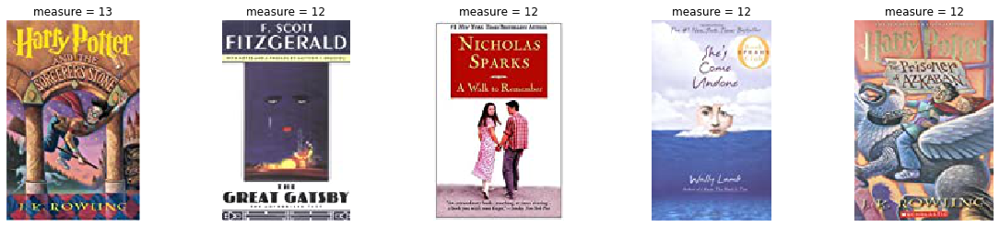

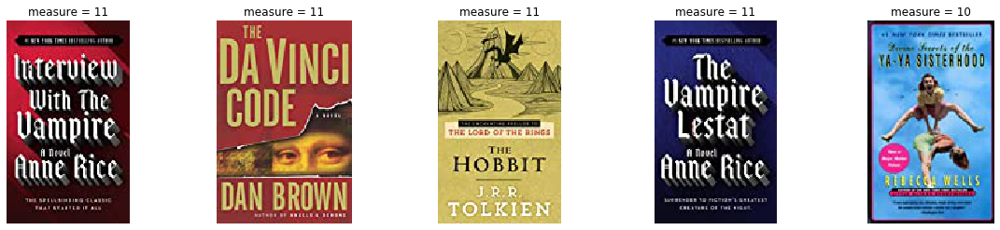

In [191]:
T = Top(interactions)
title = T.top_items(20, age = 2, country = 4)

In [185]:
title

835                                 To Kill a Mockingbird
353                                        Fahrenheit 451
696     Harry Potter and the Order of the Phoenix (Boo...
1199    Harry Potter and the Sorcerer's Stone (Harry P...
314                                The Catcher in the Rye
688      Harry Potter and the Chamber of Secrets (Book 2)
693          Harry Potter and the Goblet of Fire (Book 4)
305                             The Lovely Bones: A Novel
1266                      The Perks of Being a Wallflower
691     Harry Potter and the Prisoner of Azkaban (Book 3)
1198       Harry Potter and the Sorcerer's Stone (Book 1)
1398                                     The Great Gatsby
870                                    A Walk to Remember
1259                She's Come Undone (Oprah's Book Club)
692     Harry Potter and the Prisoner of Azkaban (Book 3)
348                            Interview with the Vampire
594                                     The Da Vinci Code
349     The Ho

</br>
Книги, которые читают люди в возрасте 22-35 лет в Англии:

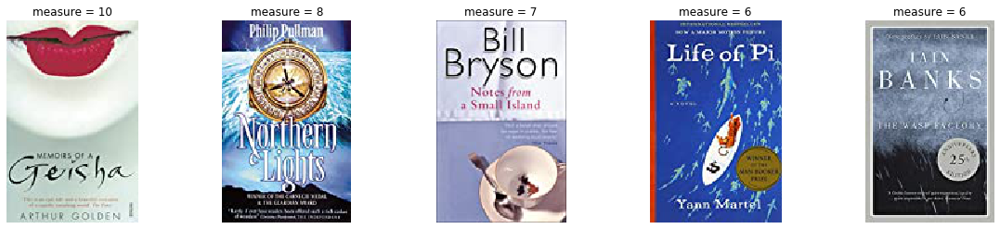

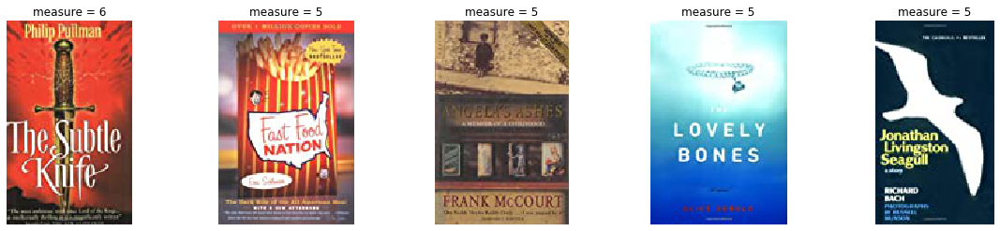

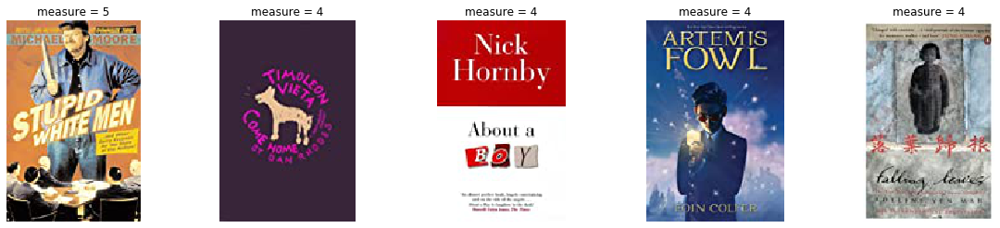

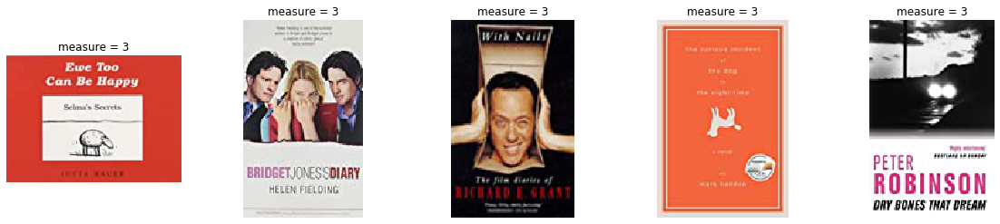

In [202]:
T = Top(interactions)
title = T.top_items(20, age = 3, country = 3)

In [203]:
title

56                                Memoirs of a Geisha Uk
389              Northern Lights (His Dark Materials S.)
348                            Notes From a Small Planet
120                                           Life of Pi
198                                     The Wasp Factory
387        The Subtle Knife (His Dark Materials, Book 2)
23     Fast Food Nation: The Dark Side of the All-Ame...
1                                          Angelas Ashes
149                            The Lovely Bones: A Novel
217                          Jonathan Livingston Seagull
12     Stupid White Men ...and Other Sorry Excuses fo...
523      Timoleon Vieta Come Home: A Sentimental Journey
384                                       About a Boy Uk
462                  Artemis Fowl (Artemis Fowl, Book 1)
82                           Falling Leaves Brit Edition
127                                 Ewe Too Can Be Happy
164                                Bridget Jones's Diary
163             With Nails the 

# Рекомендации. Кластеризация пользователей

In [9]:
from sklearn.preprocessing import normalize
from sklearn.cluster import DBSCAN, KMeans

In [38]:
csr_rates_norm = normalize(csr_rates)
csr_rates_similarity = csr_rates_norm.T @ csr_rates_norm

In [98]:
#cluster_alg = DBSCAN(eps = 1e-2, min_samples = 1, metric = "precomputed")
cluster_alg = KMeans(n_clusters = 10, precompute_distances = True)
labels = cluster_alg.fit_predict(csr_rates_similarity)
#set(labels)

In [99]:
class_col = []
for vid in interactions["user_id"]:
    class_col.append(labels[vid])
interactions['user-class'] = class_col
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,Book-Author,product_id,user_id,text,user-class,Book-Rating-mean
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,10397,3445,Das Lacheln der Fortuna: Historischer Roman,0,8.833333
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,10397,5248,Das Lacheln der Fortuna: Historischer Roman,0,8.833333
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,10397,2622,Das Lacheln der Fortuna: Historischer Roman,0,8.833333
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,10397,10887,Das Lacheln der Fortuna: Historischer Roman,0,8.833333
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,Rebecca Gable,10397,4228,Das Lacheln der Fortuna: Historischer Roman,0,8.833333
...,...,...,...,...,...,...,...,...,...,...,...,...,...
110514,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,Max Lucado,9478,1035,Traveling Light: Releasing the Burdens You Wer...,0,10.000000
110515,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,Haruki Murakami,10209,8112,Wind-Up Bird Chronicle,0,9.000000
110516,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,Alan H. Cohen,10138,8754,Why Your Life Sucks: And What You Can Do Abou...,0,8.000000
110517,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,C. S. Lewis,276,3740,Mere Christianity,0,9.000000


Посмотрим на наиболее многочисленные кластеры.

In [100]:
interactions["user-class"].value_counts()

0    108575
2       603
5       536
7       199
1       150
4       119
6        91
9        88
8        79
3        79
Name: user-class, dtype: int64

</br>Самый многочисленный кластер почти не отличается от общей картины.

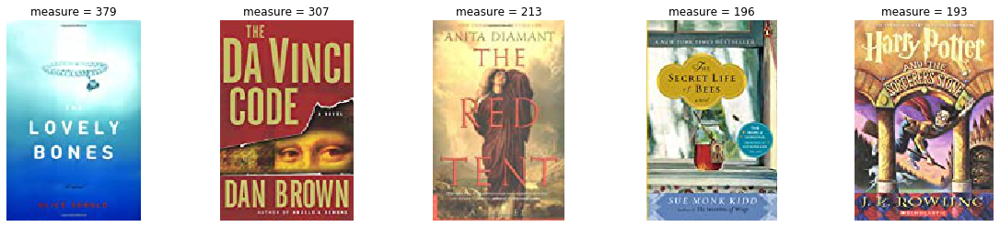

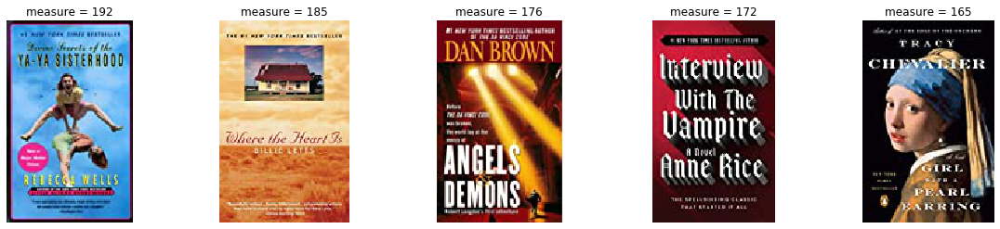

In [101]:
T = Top(interactions)
title = T.top_items(group = 0)

</br>Маленькие кластеры гораздо интереснее. В следующий кластер входят люди, предпочитающие детективные романы:

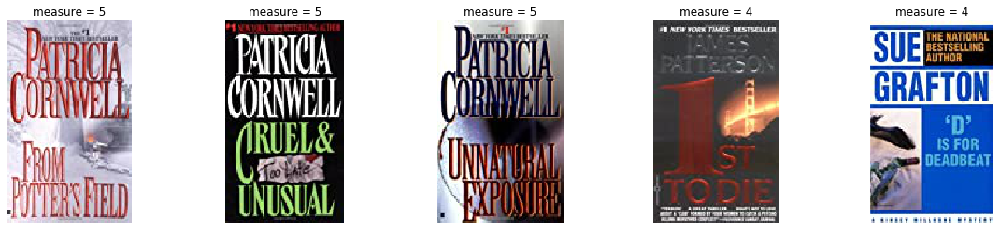

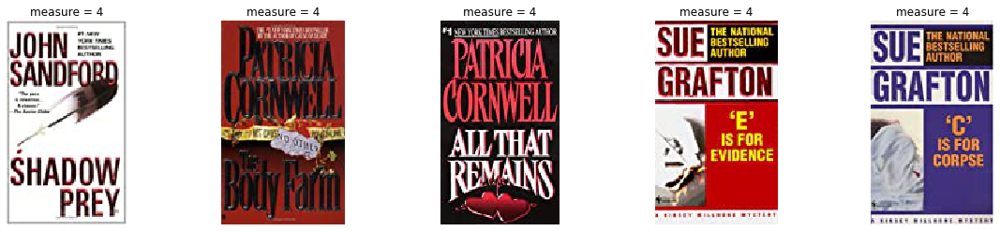

In [102]:
title = T.top_items(group = 2)

</br>В следующий кластер входят люди, предпочитающие ужастики:

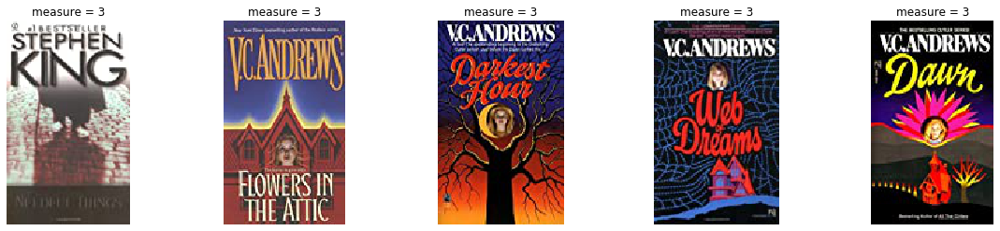

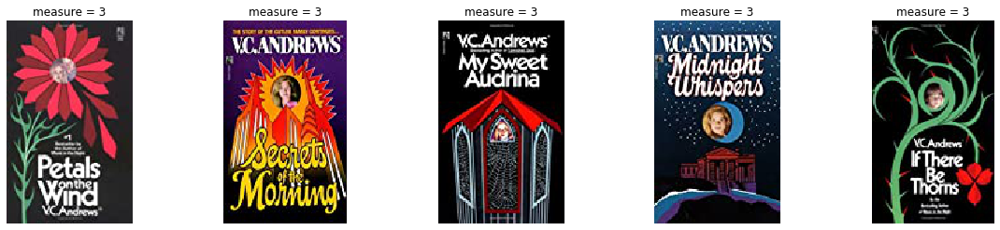

In [103]:
title = T.top_items(group = 5)

</br>В следующий кластер входят люди, предпочитающие книги в жанре психологического реализма и домашней художественной литературы:

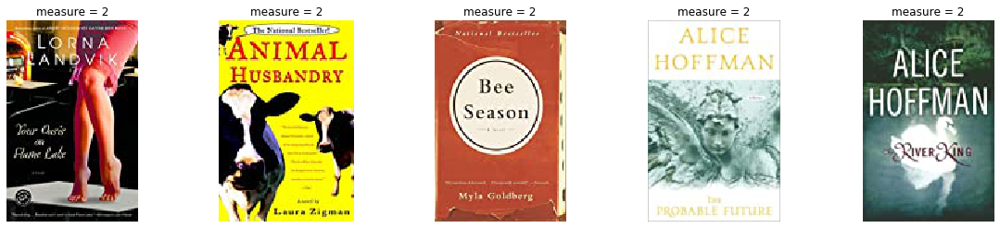

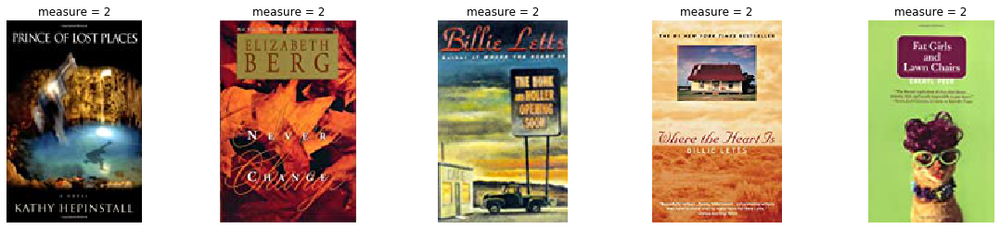

In [104]:
title = T.top_items(group = 7)

</br> В следующий кластер входят люди, предпочитающие любовные романы:

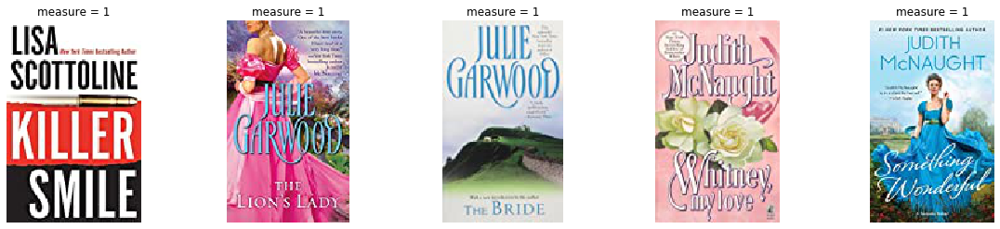

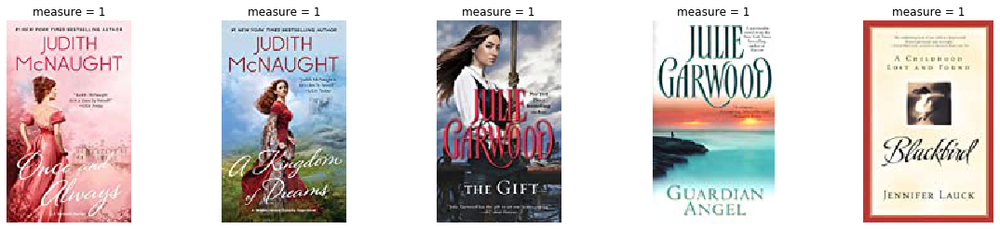

In [105]:
title = T.top_items(group = 1)

# Методы

## Совстречаемость
За вес пары возьмем полусумму средних оценок этих книг. Вместо количества встреч пары книг будем использовать сумму весов этих пар.</br>
Рекомендовать будем книги, у которых средний вес > 7.5

In [33]:
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        Int_part = interactions[["product_id", "Book-Rating-mean"]].drop_duplicates()
        self.book_rating = dict(zip(Int['product_id'], Int["Book-Rating-mean"]))
        
    def coocurrency_count(self):
        Int = self.interactions[["user_id", "product_id"]].drop_duplicates()
        user_products = Int.groupby(["user_id"])["product_id"].apply(list).reset_index()
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        user_products = user_products[user_products["prod_num"] > 1]
        
        # считаем, сколько раз товары встретились вместе
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            weigt_meet = cooc[str(i[1][j]) + "_" + str(i[1][k])]
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] =  (weigt_meet[0] + 0.5*(self.book_rating[i[1][j]] + self.book_rating[i[1][k]]),\
                                                                        weigt_meet[1] + 1)
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = (0.5*(self.book_rating[i[1][j]] + self.book_rating[i[1][k]]),1)
        cooc_list = []
        for couple, weight_meet in cooc.items():
            if weight_meet[0]/weight_meet[1] > 7.5 and weight_meet[1] > 1:
                cooc_list.append(couple.split("_") + [weight_meet[0]] + [weight_meet[0]/weight_meet[1]] + [weight_meet[1]])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "weight", "rating", "measure"])
        
    def user_recomendations(self, us_id, top_n = 10):
        Int = self.interactions[["user_id", "product_id"]].drop_duplicates()
        user_products = Int.groupby(["user_id"])["product_id"].apply(list).reset_index()
        products = list(user_products[user_products['user_id'] == us_id]["product_id"])[0]
        products_str = [str(products[k]) for k in range(len(products))]
        
        recs_frames = []
        for prod in products:
            df = self.cooc_rec[self.cooc_rec["item1"] == str(prod)]
            df = df.loc[~df['item2'].isin(products_str)]
            recs_frames.append(df\
                               .sort_values("weight", ascending=False)\
                               .head(top_n))
        recs = pd.concat(recs_frames,axis = 0) 
        recs['item2'] = recs['item2'].drop_duplicates()
        recs = recs.dropna()
        recs = recs.sort_values("weight", ascending=False).head(top_n)
        
        print(u"Книги пользователя")
        rec_imaging(products, self.product_id_to_url)
        print(u"Рекомендации для пользователя")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                    recs["rating"].values.astype(float))
    
    def get_rec(self, i, top_n = 10, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("weight", ascending=False)\
                            .head(top_n)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [34]:
cooc_rec = Recomendations(interactions)
cooc_rec.coocurrency_count()

### Рекомендации для товара

Для товара


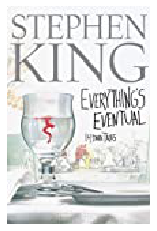

Такие рекомендации


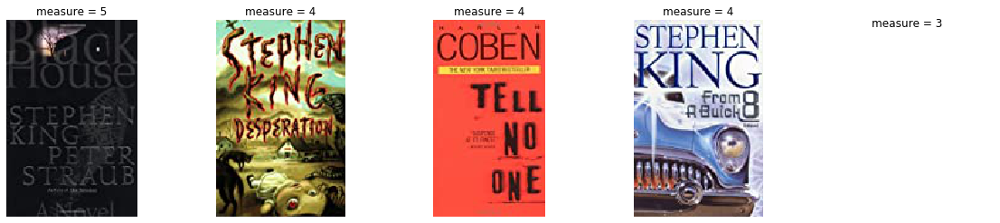

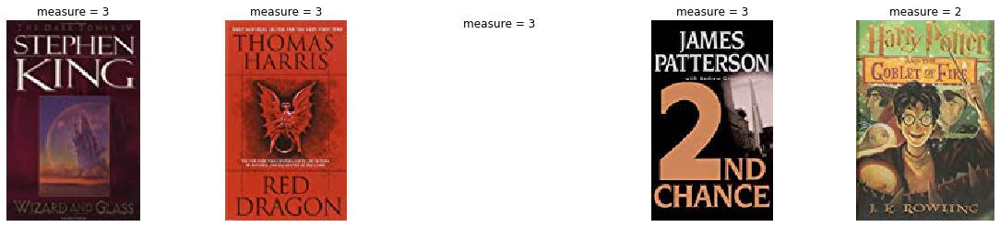

In [52]:
cooc_rec.get_rec(8519)

Для товара


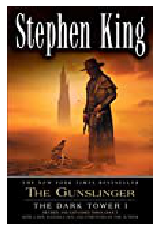

Такие рекомендации


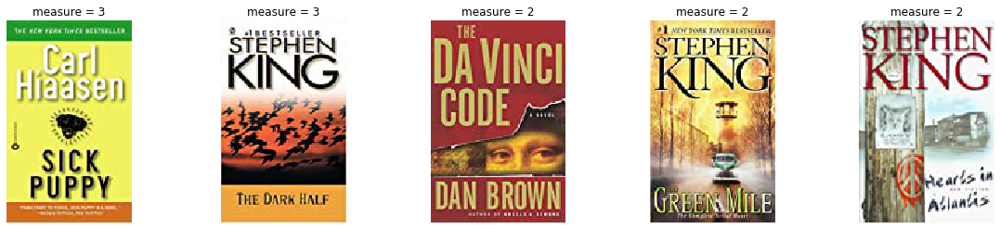

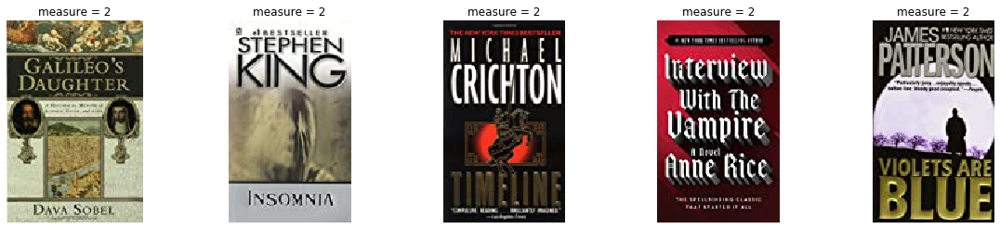

In [14]:
cooc_rec.get_rec(5877)

Для товара


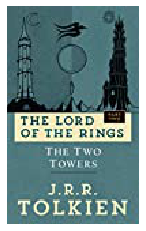

Такие рекомендации


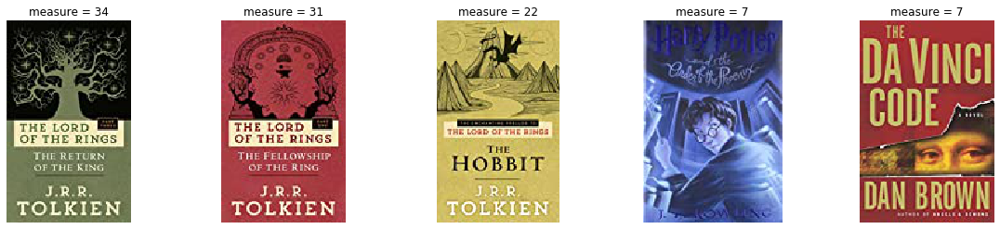

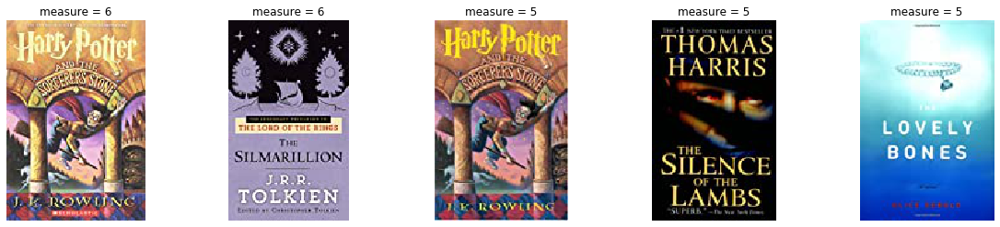

In [15]:
cooc_rec.get_rec(1923)

Для товара


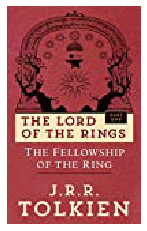

Такие рекомендации


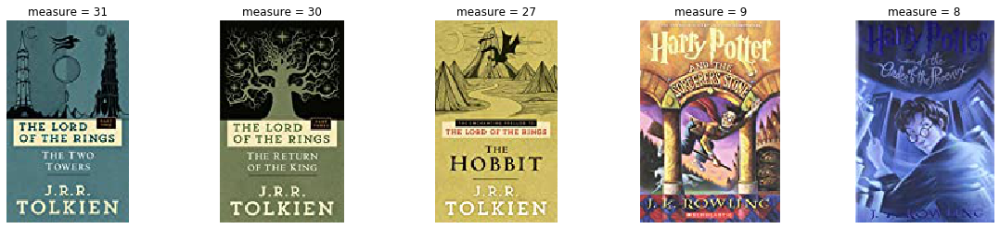

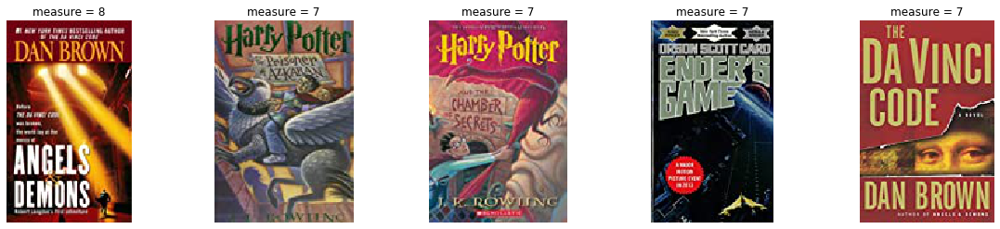

In [16]:
cooc_rec.get_rec(1922)

</br>

### Ресомендации для пользователя
Из-за того, что книги про Гарри Поттера приобретают гораздо чаще, они просто "забивают" книги Стивена Кинга.</br>
В качестве *measure* будем выводить средний вес книги. 

Книги пользователя


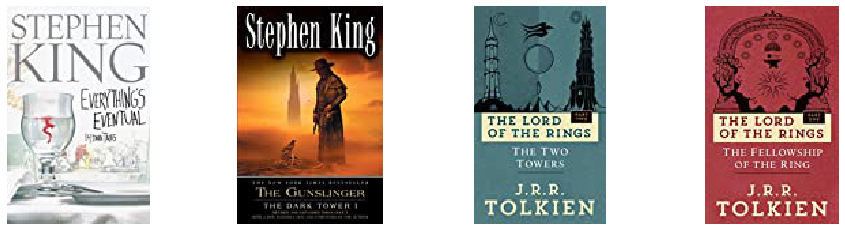

Рекомендации для пользователя


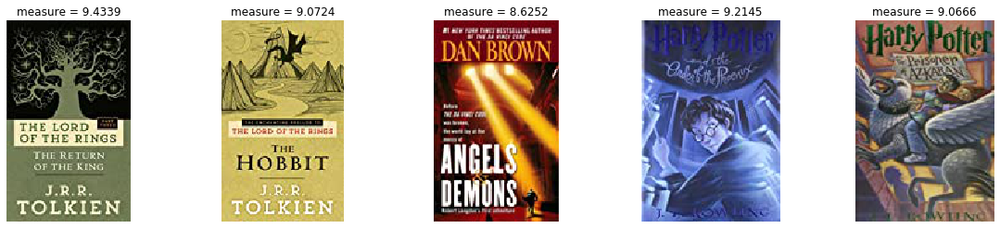

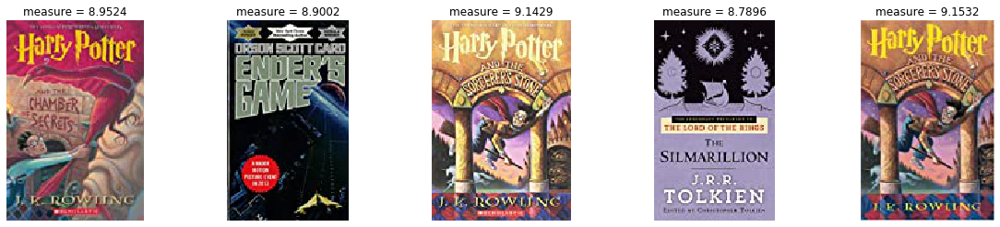

In [35]:
cooc_rec.user_recomendations(1998)

Книги пользователя


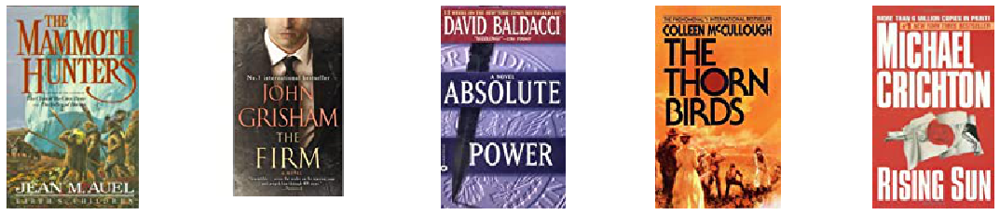

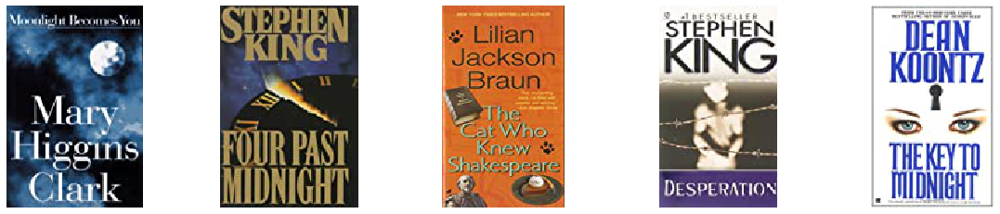

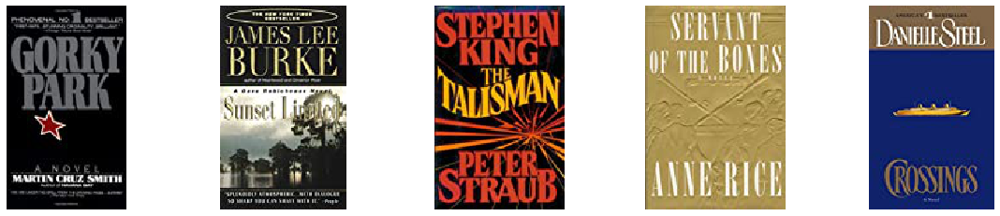

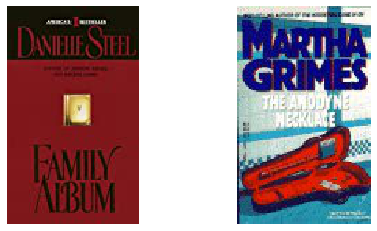

Рекомендации для пользователя


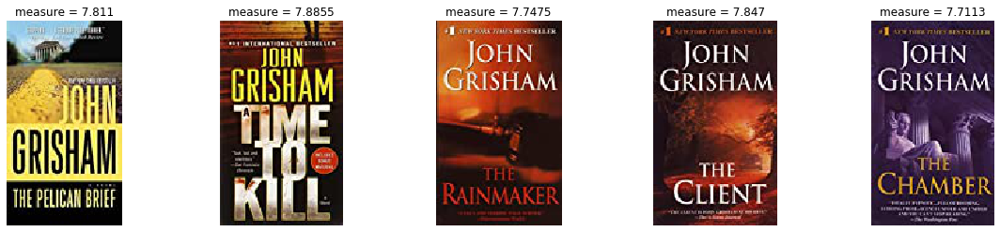

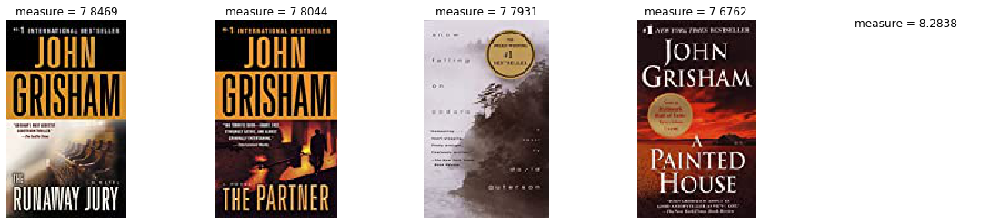

In [36]:
cooc_rec.user_recomendations(2020)

</br>

## Content-based

За текстовое описание книги возьмем ее название + автора + издательство.

В итоге, для книги (item to item) рекумендуются другие ее части (если есть), вариант той же книги от другого издательства или другого года и книги того же автора.</br>
Для пользователя (user to item) - аналогично. Здорово, что для пользователя, который читает и Стивена Кинга, и Толкина рекомендуются книги обоих авторов.

In [26]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.content_dict_title = {}
        for i, j in enumerate(items["Book-Title"]):
            self.content_dict_title[i] = j
        self.content_dict_author = {}
        for i, j in enumerate(items["Book-Author"]):
            self.content_dict_author[i] = j
        self.rating = {}
        for i, j in enumerate(items["Book-Rating-mean"]):
            self.rating[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(item_description,
                                            size=200,
                                            window=4,
                                            min_count=1,
                                            workers=10,
                                            iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        return 
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара\n")
        print(self.content_dict_title[i], " --- ", self.content_dict_author[i])
        rec_imaging([i], self.content_dict)
        items = []
        measure = []
        for k in range(1, len(np.argsort(metrics)[0][:30])):
            key = np.argsort(metrics)[0][::-1][k]
            if self.rating[key] > 7.5:
                items.append(np.argsort(metrics)[0][::-1][k])
                measure.append(np.sort(metrics)[0][::-1][k])
        items = items[:10]
        print(u"Такие рекомендации")
        for i in range(1,len(items)):
            print(self.content_dict_title[items[i]], " --- ", self.content_dict_author[items[i]])
        rec_imaging(items, self.content_dict, measure)


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["user_id"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами\n")
        for i in ui["picture_url"]:
            print(self.content_dict_title[self.inversed_dict[i]], " --- ", self.content_dict_author[self.inversed_dict[i]])
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации\n")
        items = []
        measure = []
        for k in range(1, len(np.argsort(metrics)[0][:30])):
            key = np.argsort(metrics)[0][::-1][k]
            if self.rating[key] > 7.5:
                items.append(np.argsort(metrics)[0][::-1][k])
                measure.append(np.sort(metrics)[0][::-1][k])
        items = items[:10]
        for i in range(1,len(items[:10])):
            print(self.content_dict_title[items[i]], " --- ", self.content_dict_author[items[i]])
        rec_imaging(items, self.content_dict, measure)

In [27]:
books = books.rename(columns={"Image-URL-M": "picture_url"})
books['text'] = [str(books['Book-Author'][k]) + " " + str(books['Book-Title'][k]) + " " + str(books['Publisher'][k])\
                 for k in range(books.shape[0])]
interactions['text'] = [str(interactions['Book-Author'][k]) + " " + str(interactions['Book-Title'][k]) + " " + str(interactions['Publisher'][k])\
                        for k in range(interactions.shape[0])]

In [32]:
# оставим только ье книги, у которых есть оценка
book_rating = interactions.groupby("ISBN")["Book-Rating-mean"].mean()
books = books.merge(book_rating, on=["ISBN"])
books

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,picture_url,Image-URL-L,text,Book-Rating-mean
0,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,Richard Bruce Wright Clara Callan HarperFlamin...,7.333333
1,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,Gina Bari Kolata Flu: The Story of the Great I...,7.500000
2,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,Amy Tan The Kitchen God's Wife Putnam Pub Group,8.428571
3,0440234743,The Testament,John Grisham,1999,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,John Grisham The Testament Dell,7.557692
4,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,Toni Morrison Beloved (Plume Contemporary Fict...,8.035088
...,...,...,...,...,...,...,...,...,...,...
10707,0380978482,"The Princess Diaries (The Princess Diaries, Vo...",Meg Cabot,2000,HarperCollins,http://images.amazon.com/images/P/0380978482.0...,http://images.amazon.com/images/P/0380978482.0...,http://images.amazon.com/images/P/0380978482.0...,Meg Cabot The Princess Diaries (The Princess D...,8.250000
10708,006019250X,The Illustrated Alchemist: A Fable About Follo...,Paulo Coelho,1998,HarperCollins Publishers,http://images.amazon.com/images/P/006019250X.0...,http://images.amazon.com/images/P/006019250X.0...,http://images.amazon.com/images/P/006019250X.0...,Paulo Coelho The Illustrated Alchemist: A Fabl...,9.000000
10709,3442350956,Ferne Ufer. Der 3. Band der groÃ?Â?en Highland...,Diana Gabaldon,1999,Blanvalet,http://images.amazon.com/images/P/3442350956.0...,http://images.amazon.com/images/P/3442350956.0...,http://images.amazon.com/images/P/3442350956.0...,Diana Gabaldon Ferne Ufer. Der 3. Band der gro...,9.200000
10710,0786890088,The Angel Maker,Ridley Pearson,2001,Hyperion Press,http://images.amazon.com/images/P/0786890088.0...,http://images.amazon.com/images/P/0786890088.0...,http://images.amazon.com/images/P/0786890088.0...,Ridley Pearson The Angel Maker Hyperion Press,8.500000


In [23]:
content_dict = {}
for i, j in enumerate(books["picture_url"]):
    content_dict[i] = j
inversed_dict = {v: k for k, v in content_dict.items()}
ui = interactions[interactions["user_id"] == 1998]
for i in ui["picture_url"]:
    print(inversed_dict[i])

3004
7408
382
747


In [33]:
CB = Content_Based(books, interactions)
CB.get_items_representation()

In [129]:
#CB.get_rec_I2I(3004)

Для товара

The Gunslinger (The Dark Tower, Book 1)  ---  Stephen King


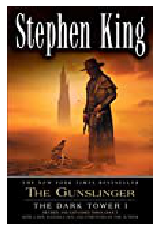

Такие рекомендации
The Gunslinger (The Dark Tower, Book 1)  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King
Wizard and Glass (The Dark Tower, Book 4)  ---  Stephen King
Wolves of the Calla (The Dark Tower, Book 5)  ---  Stephen King
The Dark Half  ---  Stephen King
Wizard and Glass (The Dark Tower, Book 4)  ---  Stephen King
The Waste Lands (The Dark Tower, Book 3)  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King


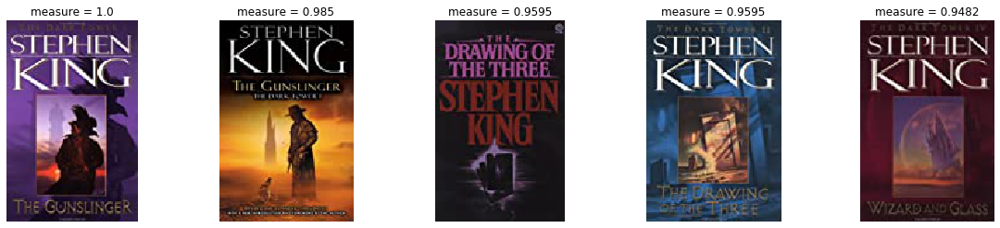

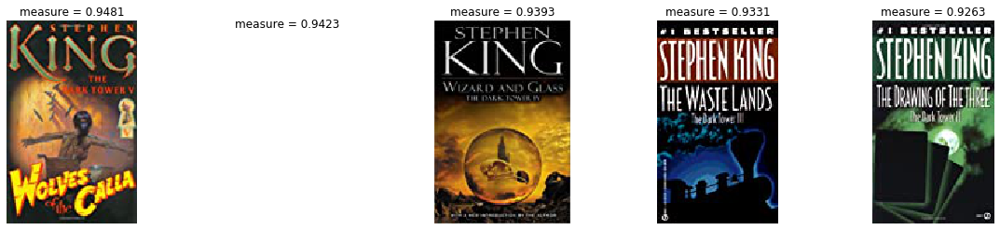

In [28]:
CB.get_rec_I2I(7408)

In [128]:
#CB.get_rec_I2I(382)

Для товара

The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J.R.R. TOLKIEN


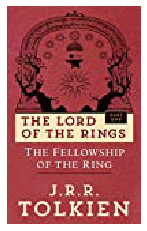

Такие рекомендации
The Two Towers (The Lord of the Rings, Part 2)  ---  J.R.R. TOLKIEN
The Hobbit and The Lord of the Rings  ---  J.R.R. TOLKIEN
The Hobbit : The Enchanting Prelude to The Lord of the Rings  ---  J.R.R. TOLKIEN
The Fellowship of the Ring (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien
The Return of the King (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien
The Two Towers (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien
The Lord of the rings,  ---  J. R. R Tolkien
The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J. R. R. Tolkien
The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J. R. R. Tolkien


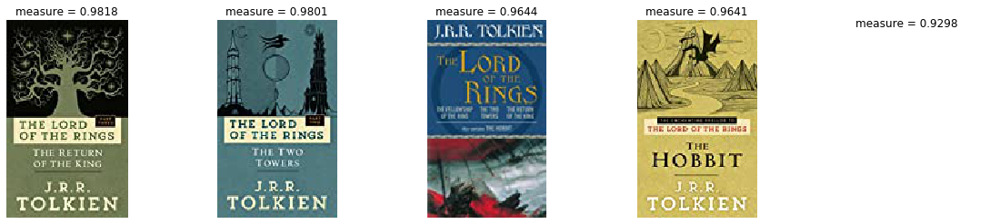

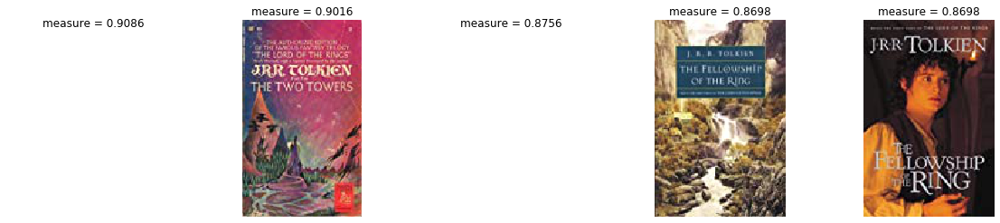

In [30]:
CB.get_rec_I2I(747)

Для пользователя, который взаимодействовал с товарами

Everything's Eventual : 14 Dark Tales  ---  Stephen King
The Gunslinger (The Dark Tower, Book 1)  ---  Stephen King
The Two Towers (The Lord of the Rings, Part 2)  ---  J.R.R. TOLKIEN
The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J.R.R. TOLKIEN


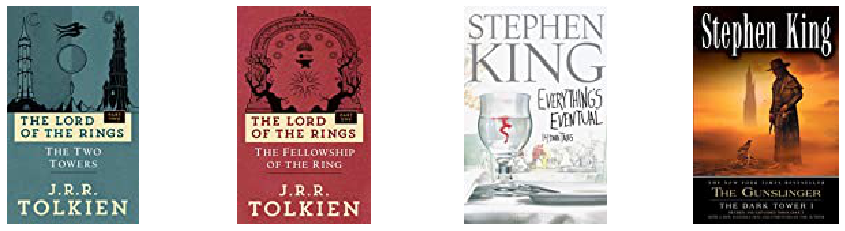

Такие рекомендации

The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J.R.R. TOLKIEN
The Return of the King (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien
The Hobbit and The Lord of the Rings  ---  J.R.R. TOLKIEN
The Hobbit : The Enchanting Prelude to The Lord of the Rings  ---  J.R.R. TOLKIEN
The Power That Preserves (The Chronicles of Thomas Covenant the Unbeliever, Book 3)  ---  Stephen R. Donaldson
The Two Towers (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King
The Fellowship of the Ring (Lord of the Rings (Paperback))  ---  J. R. R. Tolkien


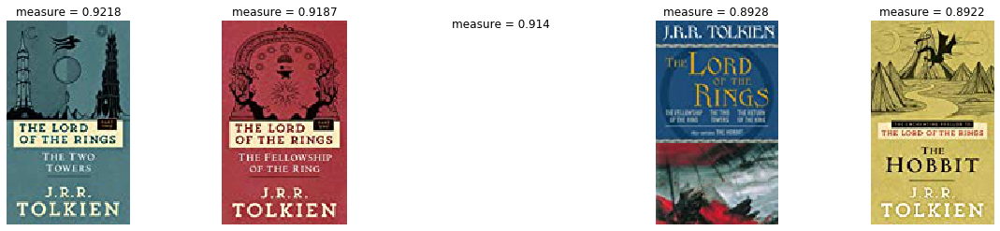

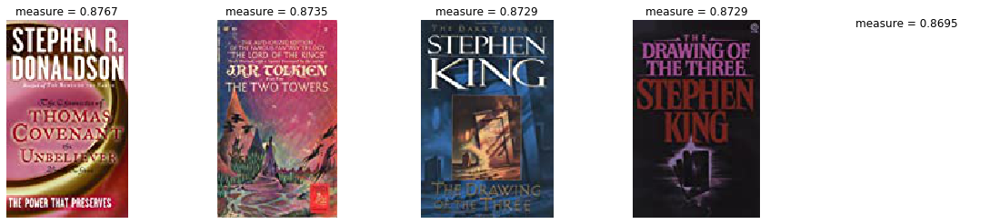

In [31]:
CB.get_rec_U2I(1998)

Для пользователя, который взаимодействовал с товарами

Mammoth Hunters (Earth's Children)  ---  Jean M. Auel
The Firm  ---  John Grisham
Absolute Power  ---  David Baldacci
The Thorn Birds  ---  Colleen McCullough
Rising Sun  ---  MICHAEL CRICHTON
MOONLIGHT BECOMES YOU  ---  Mary Higgins Clark
Four Past Midnight  ---  Stephen King
The Cat Who Knew Shakespeare  ---  Lilian Jackson Braun
Desperation  ---  Stephen King
The Key to Midnight  ---  Dean R. Koontz
Gorky Park  ---  Martin Cruz Smith
Sunset Limited (Dave Robicheaux Mysteries (Paperback))  ---  James Lee Burke
Talisman  ---  Stephen King
Servant of the Bones  ---  Anne Rice
Crossings  ---  DANIELLE STEEL
Family Album  ---  Danielle Steel
The Anodyne Necklace  ---  Martha Grimes


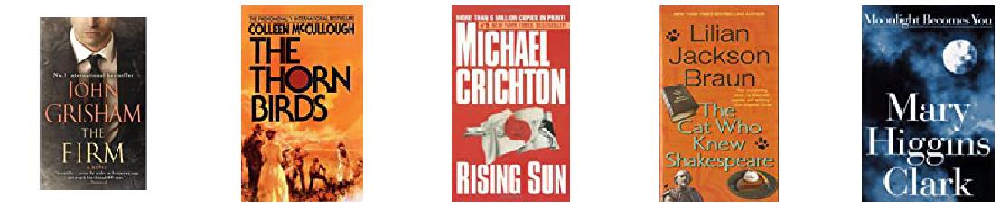

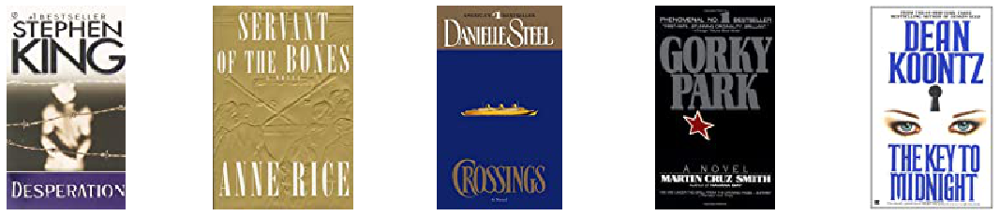

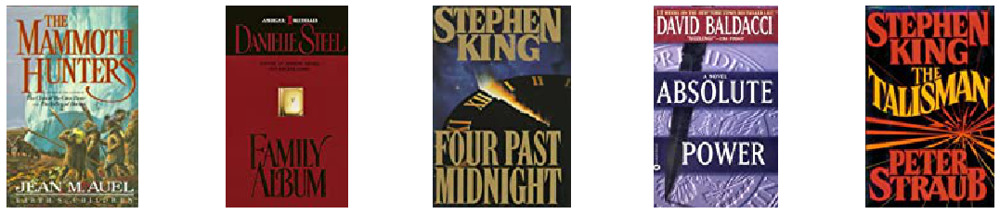

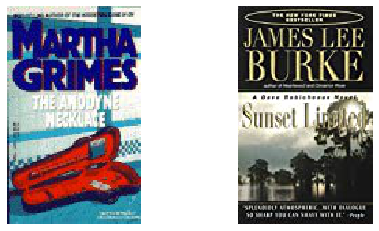

Такие рекомендации

The Talisman  ---  Stephen King
The Talisman  ---  Stephen King
The Eyes of the Dragon  ---  Stephen King
Disney's the Lion King (Little Golden Book)  ---  Justine Korman
Wizard and Glass (The Dark Tower, Book 4)  ---  Stephen King
The Eyes of the Dragon  ---  Stephen King
The Dark Half  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King
The Drawing of the Three (The Dark Tower, Book 2)  ---  Stephen King


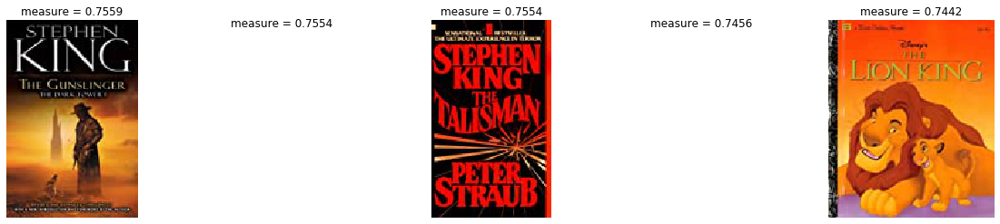

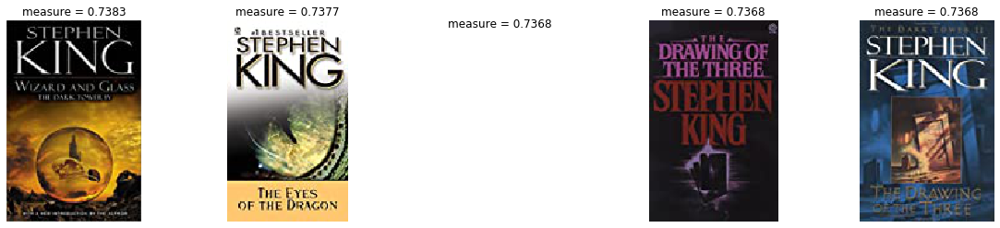

In [34]:
CB.get_rec_U2I(2020)

## Коллаборативная фильтрация
Коллоборативная фильтрация по пользователям (user-based) дает более разнообразные и достаточно хорошие рекомендации: к книгам Стивена Кинга рекомендует другие его произведения, а к повести Толкина - книги из той же серии и другую фантастику. В случае рекомендации U2I, "Властелин колец" "поглощает" Стивена Кинга и рекомендации оказываются похожи на соответсвующие I2I-рекомендации.
Коллоборативная фильтрация по товарам (item-based) дает достаточно однотипные рекомендации - некоторые книги встречаются в каждом примере, причем они не удовлетворяют общей теме.

In [130]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        values = interactions["Book-Rating"]
        self.csr_rates = coo_matrix((values, (interactions["user_id"], interactions["product_id"])), 
                            shape=(len(set(interactions["user_id"])), len(set(interactions["product_id"]))))
        
    def user_based(self, user_rates, watched_items):
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        
        mean_idx = np.mean( user_rates[np.where(user_rates > 0)] )                              # r_u_mean
        rates = np.matmul(self.csr_rates.copy().T.toarray(),  metrics)                          # \sum_v sim(u,v)*r_vi
        move_rates = np.array(np.true_divide(self.csr_rates.sum(1),(self.csr_rates!=0).sum(1))) # r_v_mean
        total_rates = np.multiply(rates - np.matmul(metrics.T, move_rates), 
                                  1/np.sum(metrics))\
                    + np.array([[mean_idx]]*rates.shape[0])
           
        # зануляем просмотренные товары
        for item in watched_items:
            total_rates[item] = [0.0]
            
        return np.argsort(total_rates[:,0])[::-1][:10], np.sort(total_rates[:,0])[::-1][:10]
    
    def item_based(self, user_rates, watched_items):
        metrics = cosine_similarity(self.csr_rates.T, self.csr_rates.T)
        rate = np.matmul(user_rates,  metrics)
        mean_rate = np.array(np.true_divide(self.csr_rates.T.sum(1),(self.csr_rates.T!=0).sum(1)))
        move_rate = np.matmul(metrics,  mean_rate).reshape(1, -1)
        total_rates = mean_rate.reshape(1, -1) + np.divide(rate - move_rate,
                                                           np.sum(metrics,axis=1))
        total_rates = total_rates.reshape(-1, 1)
            
        # зануляем просмотренные товары
        for item in watched_items:
            total_rates[item] = [0.0]
            
        return np.argsort(total_rates[:,0])[::-1][:10], np.sort(total_rates[:,0])[::-1][:10]

    def U2I(self, idx, item_based = False, user_based = False):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        if user_based:
            items, measure = self.user_based(user_rates, watched_items)
            self.get_rec(watched_items, items, measure)
            
        if item_based:
            items, measure = self.item_based(user_rates, watched_items)
            self.get_rec(watched_items, items, measure)
    
    def I2I(self, iditem, item_based = False, user_based = False):        
        user_rates = np.zeros((1,self.csr_rates.shape[1]))[0]
        user_rates[iditem] = 10
        watched_items = [iditem]
        
        if user_based:
            items, measure = self.user_based(user_rates, watched_items)
            self.get_rec(watched_items, items, measure)
            
        if item_based:
            items, measure = self.item_based(user_rates, watched_items)
            self.get_rec(watched_items, items, measure)
        
    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

Для таких товаров


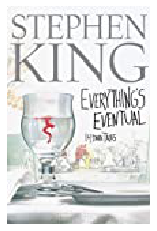

Такие рекомендации


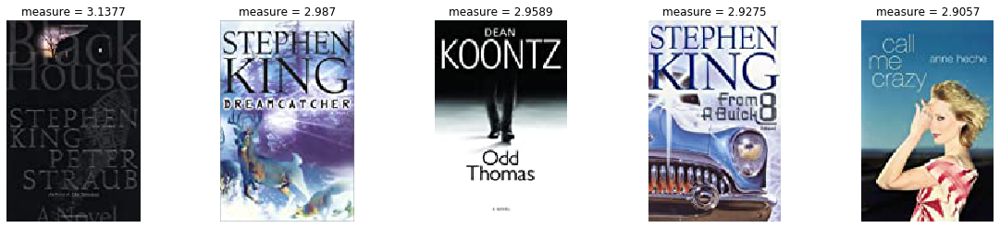

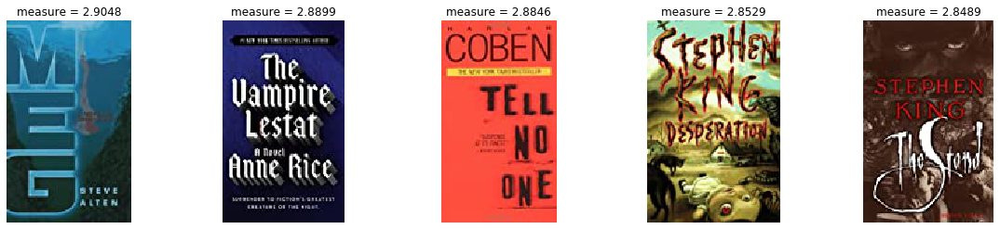

In [131]:
clb = Colloborative(interactions)
clb.I2I(8519, user_based = True)

Для таких товаров


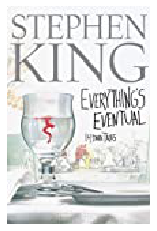

Такие рекомендации


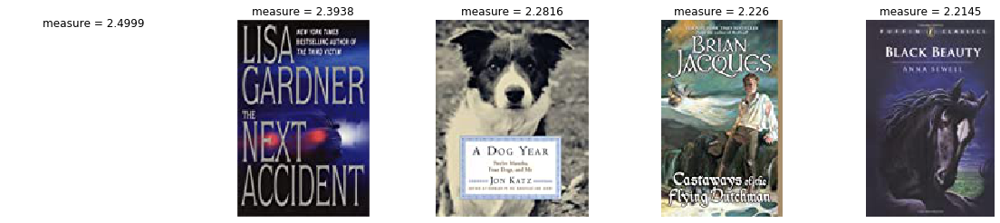

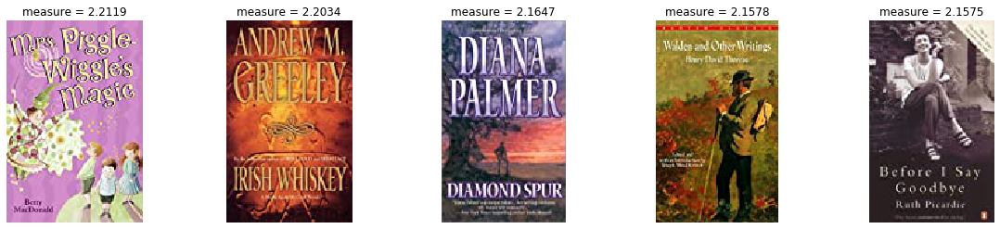

In [19]:
clb.I2I(8519, item_based = True)

Для таких товаров


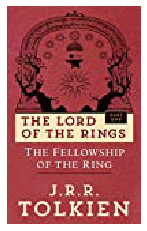

Такие рекомендации


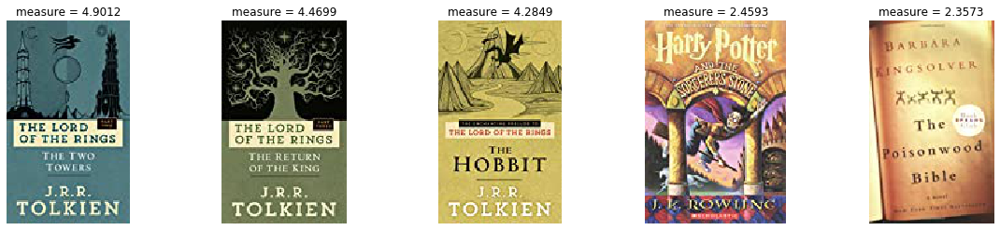

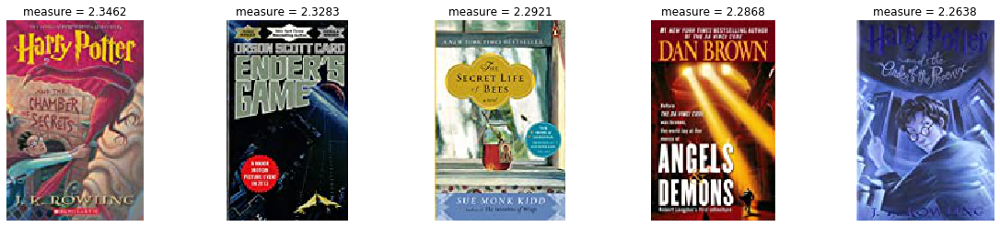

In [20]:
clb.I2I(1922, user_based = True)

Для таких товаров


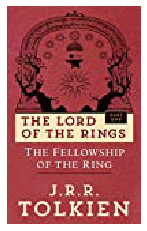

Такие рекомендации


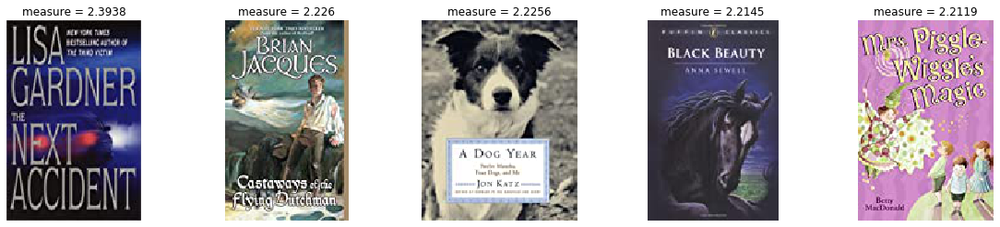

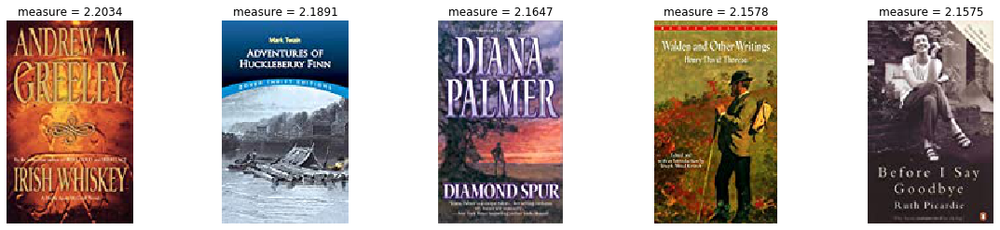

In [21]:
clb.I2I(1922, item_based = True)

Для таких товаров


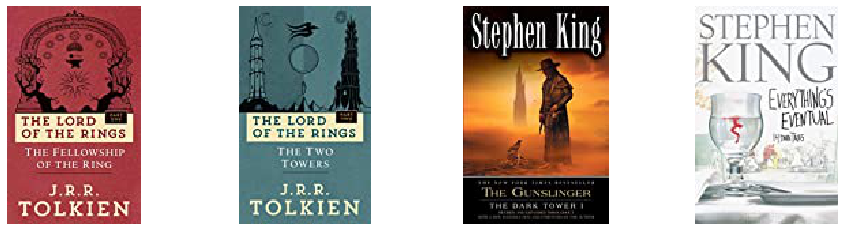

Такие рекомендации


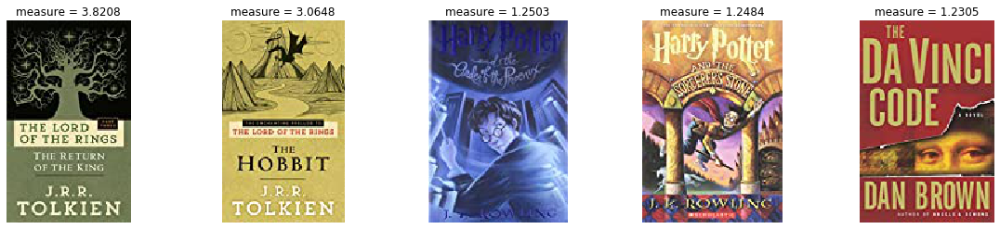

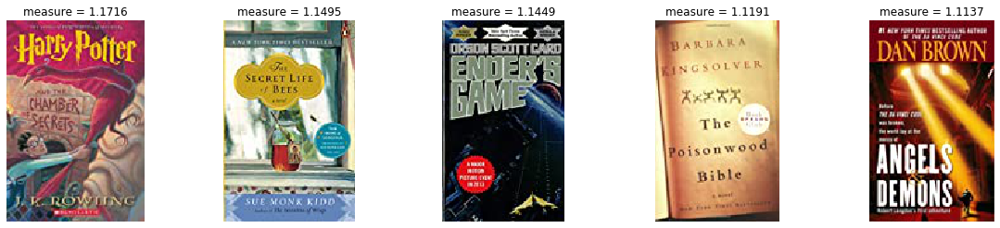

In [11]:
clb.U2I(1998, user_based = True)

Для таких товаров


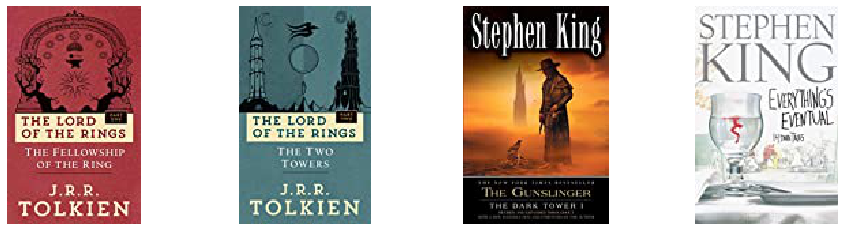

Такие рекомендации


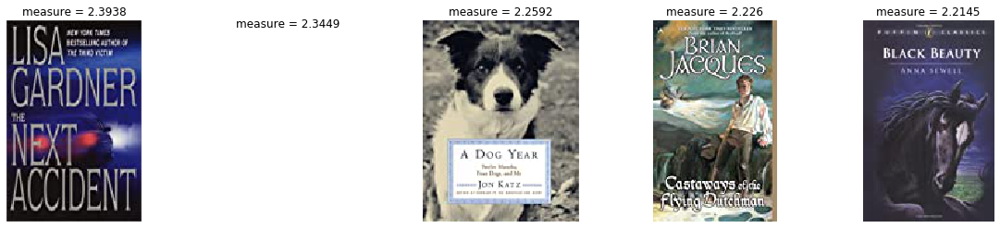

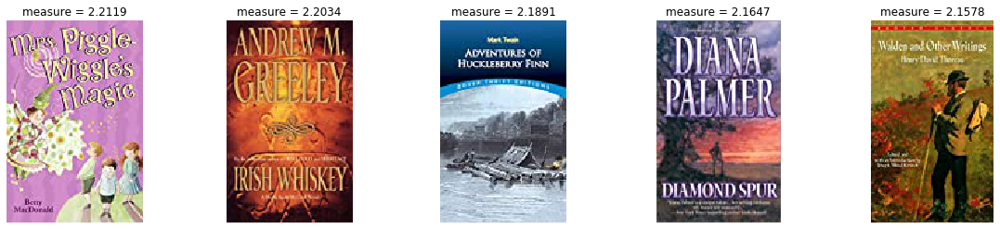

In [12]:
clb.U2I(1998, item_based = True)

Для таких товаров


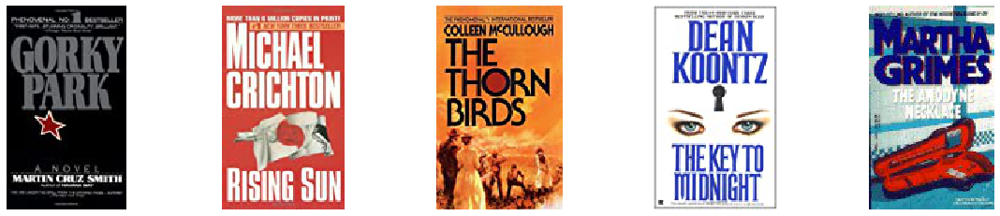

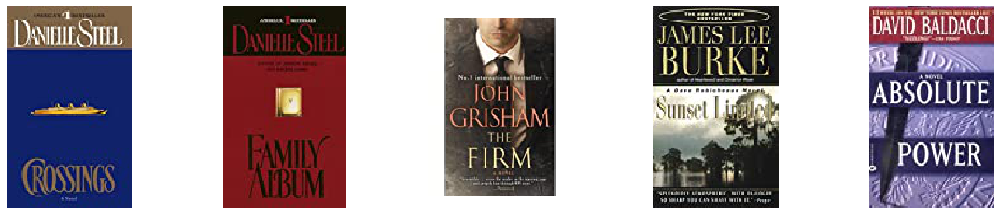

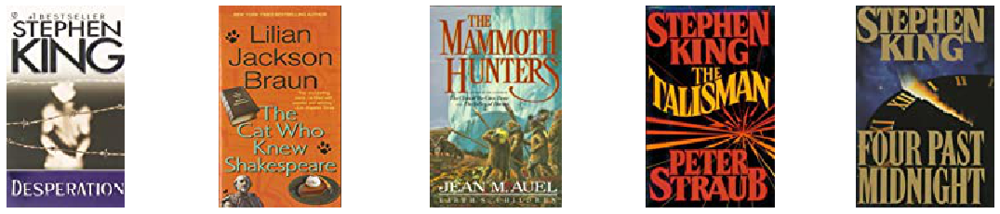

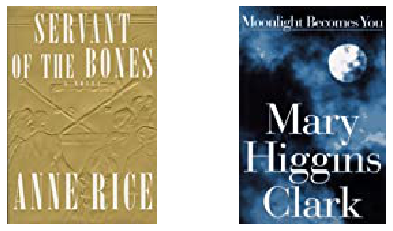

Такие рекомендации


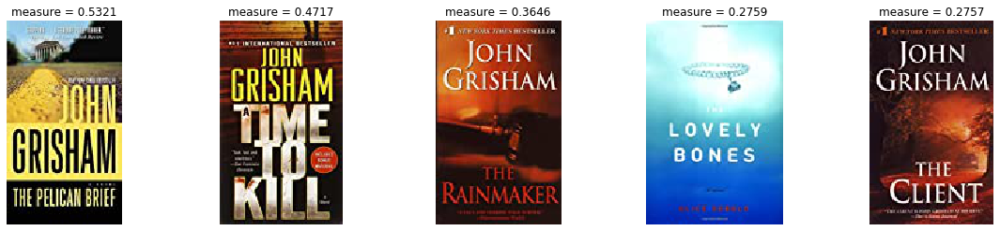

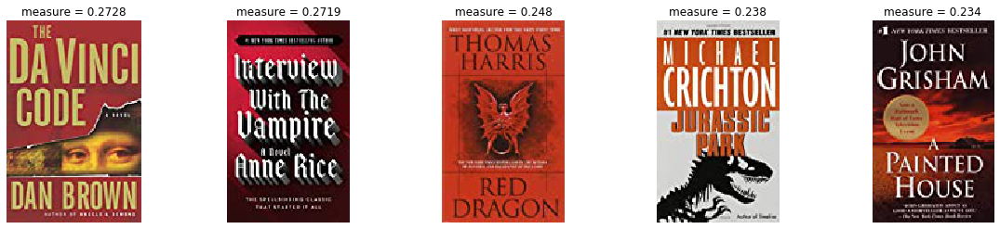

In [22]:
clb.U2I(2020, user_based = True)

## Матричная Факторизация 
Некоторые рекомендации очень удачные (например, "Дюна" Фрэнка Герберта для "Стрелка" Стивена Кинга) и странные ("Дорога в будущее" Билла Гейтса для "Властелина колец"). 

In [118]:
class MatrixFactorization():    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        self.content_dict_title = {}
        for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
            self.content_dict_title[i] = j
        self.content_dict_author = {}
        for i, j in interactions[["product_id", "Book-Author"]].drop_duplicates().values:
            self.content_dict_author[i] = j
        values = interactions["Book-Rating"]
        self.csr_rates = coo_matrix((values, (interactions["user_id"], interactions["product_id"])), 
                            shape=(len(set(interactions["user_id"])), len(set(interactions["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=300, learning_rate=0.01, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара\n")
        print(self.content_dict_title[i], ' --- ', self.content_dict_author[i])
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации\n")
        for i in np.argsort(-metrics)[0][1:11]:
            print(self.content_dict_title[i], ' --- ', self.content_dict_author[i])
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))
    
    def U2I(self, idx):
        watched_items = np.where(self.csr_rates.getrow(idx).toarray()[0] != 0)[0]
        recomend_items = []
        measure_items = []
        for i in watched_items:
            metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
            recomend_items = recomend_items + list(np.argsort(-metrics)[0][1:11])
            measure_items = measure_items + list(-np.round(np.sort(-metrics)[0][1:11], 4))
            
        recomendation = [-1]*len(set(recomend_items))
        measure = np.zeros(len(set(recomend_items)))
        k = 0
        for i in set(recomend_items):
            if i in watched_items:
                measure[k] = 0
            else:
                measure[k] = np.mean(np.array(measure_items)[np.where(np.array(recomend_items) == i)[0]])
            recomendation[k] = i
            k += 1
        print(u"Для таких товаров")
        rec_imaging([i for i in watched_items], self.content_dict)
        
        print(u"Такие рекомендации\n")
        rec_items = []
        for i in np.argsort(-measure)[1:11]:
            print(self.content_dict_title[recomendation[i]], ' --- ', self.content_dict_author[recomendation[i]])
            rec_items.append(recomendation[i])   
        rec_imaging(rec_items, self.content_dict, np.sort(measure)[::-1][1:11])

In [121]:
simple_svd = MatrixFactorization(interactions, 300)
simple_svd.MF()

Для товара

Everything's Eventual : 14 Dark Tales  ---  Stephen King


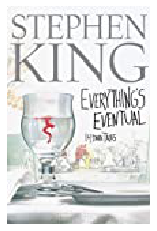

Такие рекомендации

Black House  ---  Stephen King
The Anatomy of Motive : The FBI's Legendary Mindhunter Explores the Key to Understanding and Catching Violent Criminals  ---  John Douglas
Birdy M/TV  ---  William Wharton
Boondocking  ---  Tricia Bauer
Ambulance Girl: How I Saved Myself by Becoming an EMT  ---  JANE STERN
Electric God  ---  Catherine Ryan Hyde
The Red Room  ---  Nicci French
The Many Lives &amp; Secret Sorrows of Josephine B.  ---  Sandra Gulland
Dreamcatcher  ---  Stephen King
Desperation  ---  Stephen King


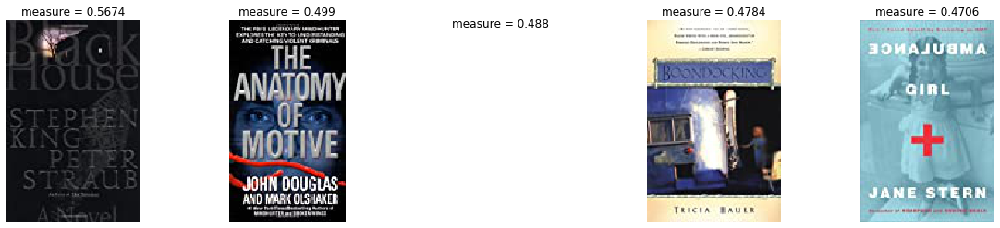

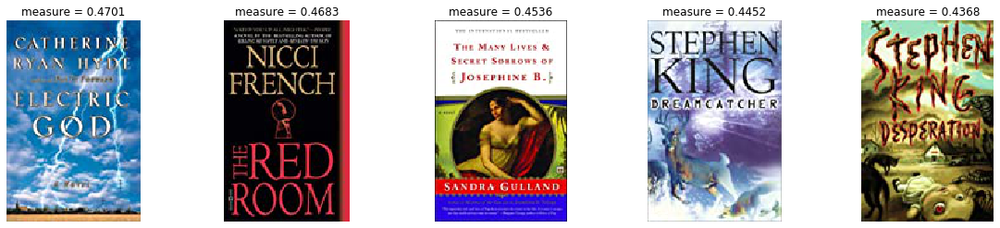

In [122]:
simple_svd.I2I(8519)

Для товара

The Gunslinger (The Dark Tower, Book 1)  ---  Stephen King


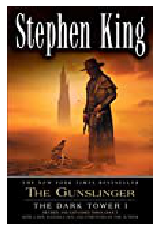

Такие рекомендации

Galileo's Daughter: A Historical Memoir of Science, Faith, and Love  ---  Dava Sobel
The Great Train Robbery  ---  Michael Crichton
Gunmans Rhapsody  ---  Robert B. Parker
STREETS OF LAREDO  ---  Larry McMurtry
Parliament of Whores: A Lone Humorist Attempts to Explain the Entire U.S. Government  ---  P. J. O'Rourke
Bright lights, big city: A novel  ---  Jay McInerney
FLIGHT OF INTRUDER  ---  Stephen Coonts
The Butlerian Jihad (Dune Series)  ---  Brian Herbert
Talking God (Jim Chee Novels)  ---  Tony Hillerman
House Corrino (Dune: House Trilogy, Book 3)  ---  Brian Herbert


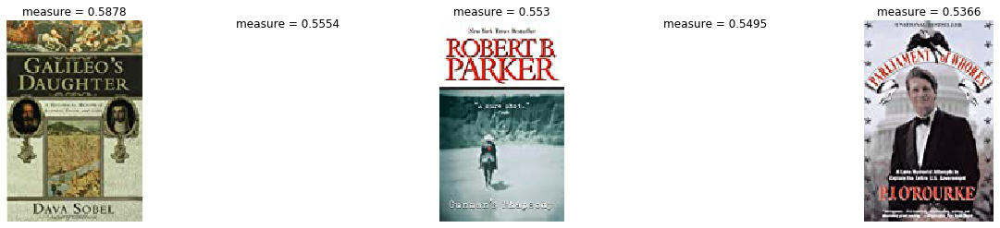

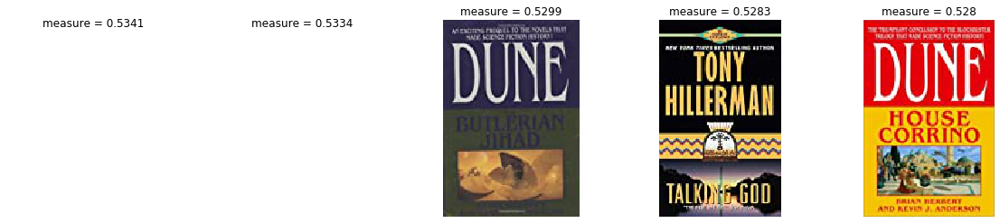

In [123]:
simple_svd.I2I(5877)

Для товара

The Two Towers (The Lord of the Rings, Part 2)  ---  J.R.R. TOLKIEN


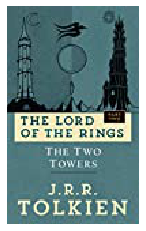

Такие рекомендации

The Return of the King (The Lord of the Rings, Part 3)  ---  J.R.R. TOLKIEN
The Law  ---  Frederic Bastiat
The B. F. G.: Dahl (Puffin Books)  ---  Roald Dahl
Burning Water (Burning Water)  ---  Mercedes Lackey
Irisches Tagebuch  ---  Heinrich BÃ¶ll
Die Asche Meiner Mutter  ---  Frank McCourt
Das Jesus Video.  ---  Andreas Eschbach
Das Achte Gebot  ---  Anne Holt
Der Club der toten Dichter. Roman.  ---  Nancy H. Kleinbaum
Der Fanger Im Roggen  ---  Jerome D. Salinger


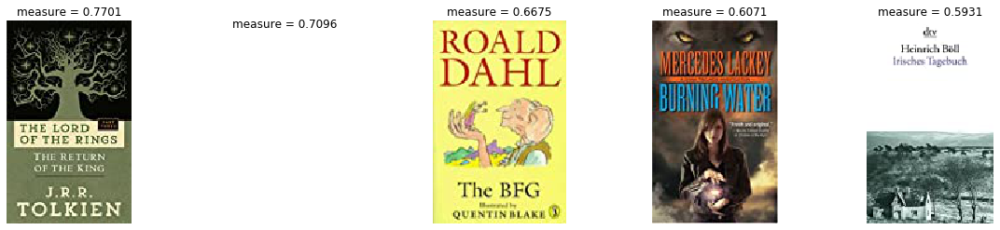

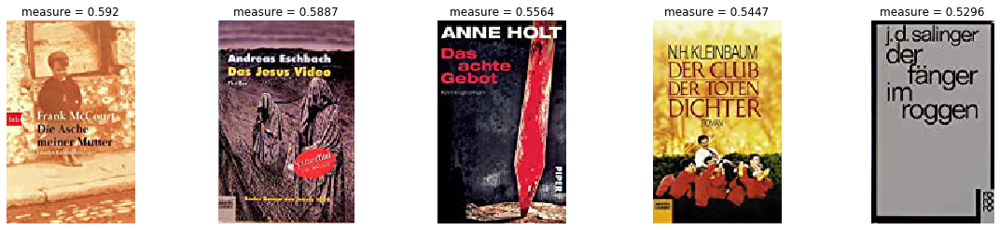

In [124]:
simple_svd.I2I(1923)

Для товара

The Fellowship of the Ring (The Lord of the Rings, Part 1)  ---  J.R.R. TOLKIEN


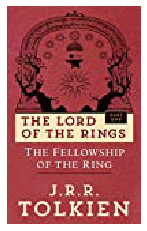

Такие рекомендации

The Law  ---  Frederic Bastiat
Tess of the D'Urbervilles (Wordsworth Classics)  ---  Thomas Hardy
The Road Ahead (CD ROM included)  ---  Bill Gates
The B. F. G.: Dahl (Puffin Books)  ---  Roald Dahl
Irisches Tagebuch  ---  Heinrich BÃ¶ll
Die Asche Meiner Mutter  ---  Frank McCourt
Der Kleine Hobbit  ---  J. R. R. Tolkien
Das Jesus Video.  ---  Andreas Eschbach
Twice Shy  ---  Dick Francis
Glimmering  ---  Elizabeth Hand


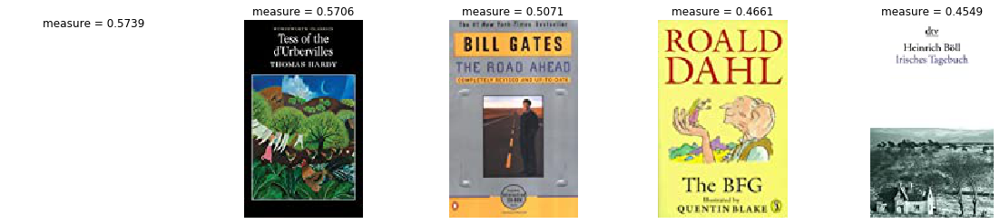

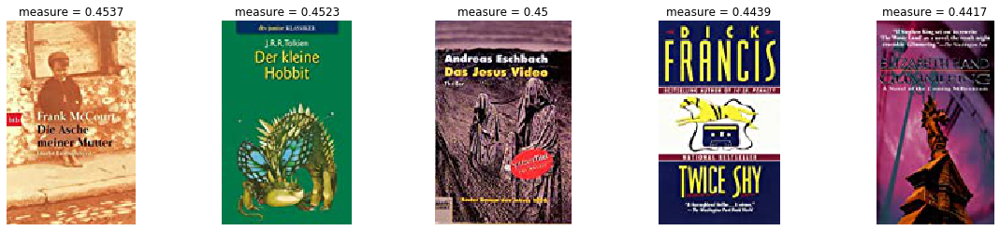

In [125]:
simple_svd.I2I(1922)

Для таких товаров


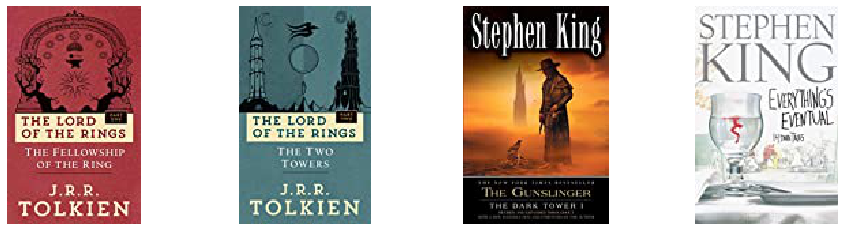

Такие рекомендации

The Law  ---  Frederic Bastiat
Burning Water (Burning Water)  ---  Mercedes Lackey
Galileo's Daughter: A Historical Memoir of Science, Faith, and Love  ---  Dava Sobel
Tess of the D'Urbervilles (Wordsworth Classics)  ---  Thomas Hardy
Black House  ---  Stephen King
The B. F. G.: Dahl (Puffin Books)  ---  Roald Dahl
Das Achte Gebot  ---  Anne Holt
The Great Train Robbery  ---  Michael Crichton
Gunmans Rhapsody  ---  Robert B. Parker
STREETS OF LAREDO  ---  Larry McMurtry


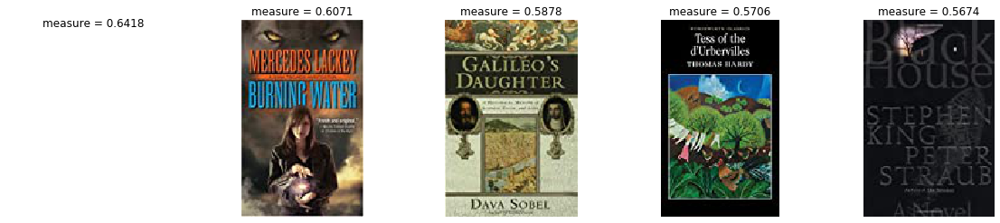

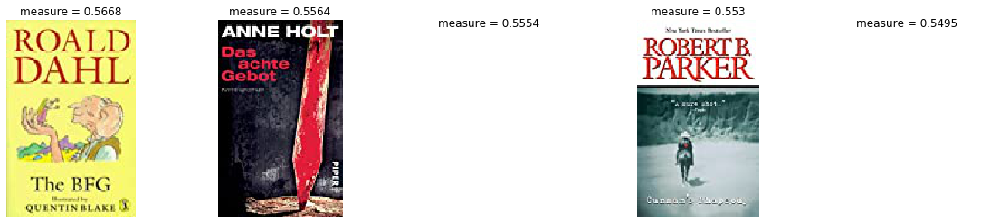

In [126]:
simple_svd.U2I(1998)

Для таких товаров


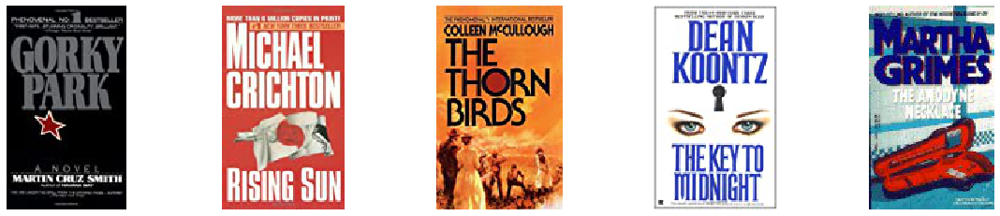

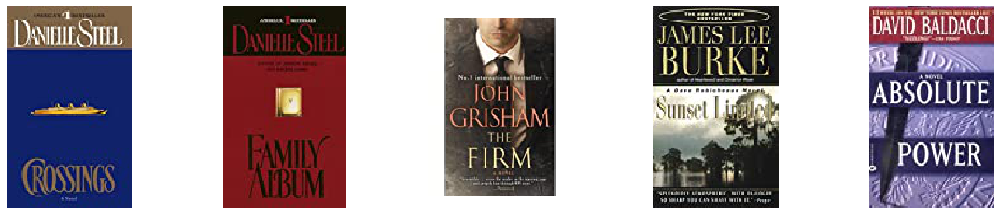

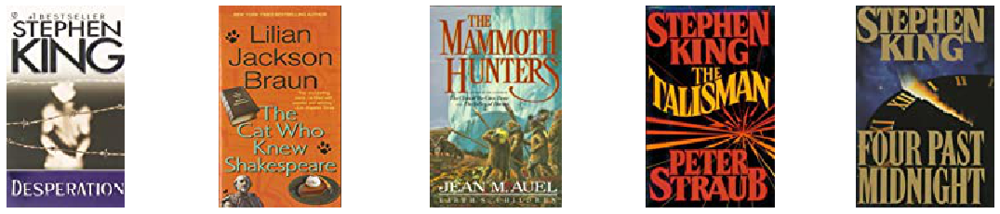

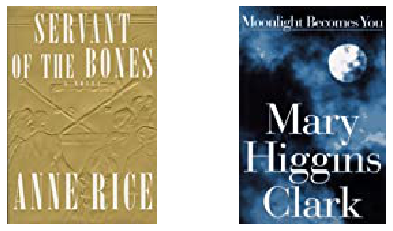

Такие рекомендации

Comes the Dark  ---  Michael Prescott
Paradise County  ---  Karen Robards
Fault Lines  ---  Anne Rivers Siddons
Nightmares &amp; Dreamscapes  ---  Stephen King
Vulcan's Forge (Philip Mercer)  ---  Jack B. Du Brul
The Sabbathday River  ---  Jean Hanff Korelitz
St. Raven  ---  Jo Beverley
LEGEND  ---  Jude Deveraux
Skull Beneath the Skin  ---  P D James
Suspicion of Betrayal  ---  Barbara Parker


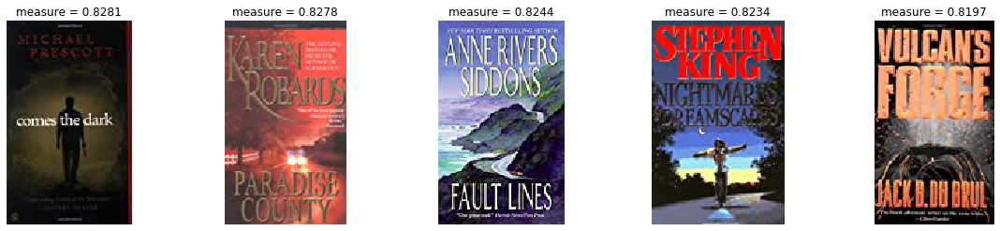

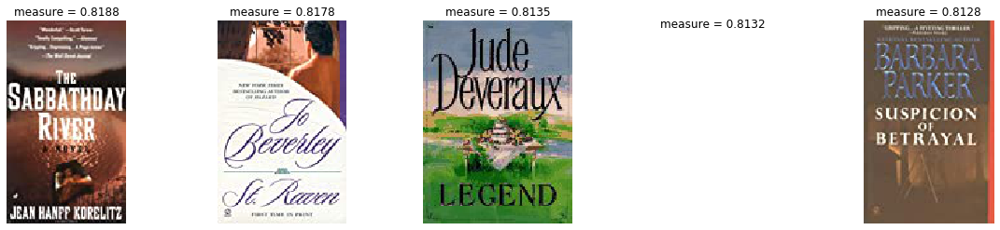

In [127]:
simple_svd.U2I(2020)